# EDA - Time - Clusters

In [112]:
# -*- coding: utf-8 -*-
"""
Analisis de la producción cientifica a traves del tiempo
"""


'\nAnalisis de la producción cientifica a traves del tiempo\n'

In [113]:
# Importar librerías
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt 
from matplotlib.pyplot import figure
import plotly.express as px
import seaborn as sns
import plotly.graph_objects as go
from sklearn.linear_model import LinearRegression


## Data

Cluster.infoInstituciones.csv https://drive.google.com/drive/u/0/folders/1APVnfD1zPgTHFAr0YMG6UMTwZ52MQVa9

Cluster.cluster.csv https://drive.google.com/file/d/16hq2o-oAD0chAqEgqEKn9Uu_dOitLPcj/view

In [114]:
#Data
df = pd.read_csv("Cluster.infoInstituciones.csv")#encoding="latin-1")
df

df.year=df.year.astype(int)
df

,Instituciones,grupo,year,articulos,SJR_Q_Q1,SJR_Q_Q2,SJR_Q_Q3,SJR_Q_Q4,capitulos,innovaciones,...,trabajos_grado,integrantes,doctorado,maestria,Especializacion,pregrado,Investigador_Asociado,Investigador_Emerito,Investigador_Junior,Investigador Senior
0,A.I.D Biohacking Colombia Avalado,1,2017,4.0,0.0,0.0,1.0,1.0,0.0,0.0,...,0.0,6.0,1.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0
1,Aalborg University No Avalado,1,2012,10.0,1.0,3.0,1.0,2.0,4.0,0.0,...,13.0,13.0,7.0,1.0,0.0,3.0,0.0,0.0,1.0,0.0
2,Abogato Jurídico S.A.S. Avalado,1,2018,2.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,6.0,0.0,1.0,1.0,2.0,0.0,0.0,0.0,0.0
3,Abya-Ayala No Avalado,1,2014,9.0,0.0,0.0,2.0,7.0,0.0,0.0,...,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
4,Academia Américana De Psiquiatría No Avalado,1,2008,5.0,0.0,0.0,0.0,0.0,12.0,0.0,...,10.0,40.0,1.0,10.0,1.0,16.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1437,Washington State University No Avalado,1,2010,31.0,11.0,2.0,0.0,1.0,7.0,0.0,...,7.0,25.0,6.0,10.0,1.0,8.0,0.0,0.0,3.0,0.0
1438,Yarima Guadua E. U. No Avalado,1,2000,141.0,18.0,14.0,14.0,24.0,19.0,0.0,...,131.0,62.0,10.0,22.0,3.0,20.0,0.0,0.0,6.0,3.0
1439,"Yoluka Ong, Fundación De Investigación En Biod...",1,2008,25.0,2.0,4.0,7.0,2.0,18.0,0.0,...,16.0,6.0,1.0,3.0,0.0,2.0,0.0,0.0,2.0,0.0
1440,Zumo Tecnologia Avalado,1,2013,0.0,0.0,0.0,0.0,0.0,0.0,11.0,...,7.0,10.0,0.0,5.0,1.0,4.0,0.0,0.0,2.0,0.0


In [115]:
df.columns

Index(['Instituciones', 'grupo', 'year', 'articulos', 'SJR_Q_Q1', 'SJR_Q_Q2',
       'SJR_Q_Q3', 'SJR_Q_Q4', 'capitulos', 'innovaciones', 'libros',
       'softwares', 'trabajos_grado', 'integrantes', 'doctorado', 'maestria',
       'Especializacion', 'pregrado', 'Investigador_Asociado',
       'Investigador_Emerito', 'Investigador_Junior', 'Investigador Senior'],
      dtype='object')

In [116]:
dfi = pd.read_csv("Cluster.cluster.csv") #encoding="latin-1")
dfi

,Unnamed: 0,articulos,SJR_Q_Q1,SJR_Q_Q2,SJR_Q_Q3,SJR_Q_Q4,capitulos,innovaciones,libros,softwares,...,doctorado,maestria,Especializacion,pregrado,Investigador_Asociado,Investigador_Emerito,Investigador_Junior,Investigador Senior,Instituciones,Cluster
0,0,4.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,...,1.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,A.I.D Biohacking Colombia Avalado,4
1,1,10.0,1.0,3.0,1.0,2.0,4.0,0.0,1.0,0.0,...,7.0,1.0,0.0,3.0,0.0,0.0,1.0,0.0,Aalborg University No Avalado,4
2,2,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,1.0,2.0,0.0,0.0,0.0,0.0,Abogato Jurídico S.A.S. Avalado,4
3,3,9.0,0.0,0.0,2.0,7.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,Abya-Ayala No Avalado,4
4,4,5.0,0.0,0.0,0.0,0.0,12.0,0.0,0.0,1.0,...,1.0,10.0,1.0,16.0,0.0,0.0,1.0,0.0,Academia Américana De Psiquiatría No Avalado,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1437,1437,31.0,11.0,2.0,0.0,1.0,7.0,0.0,2.0,0.0,...,6.0,10.0,1.0,8.0,0.0,0.0,3.0,0.0,Washington State University No Avalado,1
1438,1438,141.0,18.0,14.0,14.0,24.0,19.0,0.0,0.0,0.0,...,10.0,22.0,3.0,20.0,0.0,0.0,6.0,3.0,Yarima Guadua E. U. No Avalado,3
1439,1439,25.0,2.0,4.0,7.0,2.0,18.0,0.0,0.0,0.0,...,1.0,3.0,0.0,2.0,0.0,0.0,2.0,0.0,"Yoluka Ong, Fundación De Investigación En Biod...",4
1440,1440,0.0,0.0,0.0,0.0,0.0,0.0,11.0,0.0,0.0,...,0.0,5.0,1.0,4.0,0.0,0.0,2.0,0.0,Zumo Tecnologia Avalado,4


In [117]:
dfi.columns

Index(['Unnamed: 0', 'articulos', 'SJR_Q_Q1', 'SJR_Q_Q2', 'SJR_Q_Q3',
       'SJR_Q_Q4', 'capitulos', 'innovaciones', 'libros', 'softwares',
       'trabajos_grado', 'integrantes', 'doctorado', 'maestria',
       'Especializacion', 'pregrado', 'Investigador_Asociado',
       'Investigador_Emerito', 'Investigador_Junior', 'Investigador Senior',
       'Instituciones', 'Cluster'],
      dtype='object')

In [118]:
clusters = dfi["Cluster"]

In [119]:
dfm = df.join(clusters) #append 'Cluster' to 'df'
dfm


,Instituciones,grupo,year,articulos,SJR_Q_Q1,SJR_Q_Q2,SJR_Q_Q3,SJR_Q_Q4,capitulos,innovaciones,...,integrantes,doctorado,maestria,Especializacion,pregrado,Investigador_Asociado,Investigador_Emerito,Investigador_Junior,Investigador Senior,Cluster
0,A.I.D Biohacking Colombia Avalado,1,2017,4.0,0.0,0.0,1.0,1.0,0.0,0.0,...,6.0,1.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,4
1,Aalborg University No Avalado,1,2012,10.0,1.0,3.0,1.0,2.0,4.0,0.0,...,13.0,7.0,1.0,0.0,3.0,0.0,0.0,1.0,0.0,4
2,Abogato Jurídico S.A.S. Avalado,1,2018,2.0,0.0,0.0,0.0,0.0,0.0,0.0,...,6.0,0.0,1.0,1.0,2.0,0.0,0.0,0.0,0.0,4
3,Abya-Ayala No Avalado,1,2014,9.0,0.0,0.0,2.0,7.0,0.0,0.0,...,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,4
4,Academia Américana De Psiquiatría No Avalado,1,2008,5.0,0.0,0.0,0.0,0.0,12.0,0.0,...,40.0,1.0,10.0,1.0,16.0,0.0,0.0,1.0,0.0,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1437,Washington State University No Avalado,1,2010,31.0,11.0,2.0,0.0,1.0,7.0,0.0,...,25.0,6.0,10.0,1.0,8.0,0.0,0.0,3.0,0.0,1
1438,Yarima Guadua E. U. No Avalado,1,2000,141.0,18.0,14.0,14.0,24.0,19.0,0.0,...,62.0,10.0,22.0,3.0,20.0,0.0,0.0,6.0,3.0,3
1439,"Yoluka Ong, Fundación De Investigación En Biod...",1,2008,25.0,2.0,4.0,7.0,2.0,18.0,0.0,...,6.0,1.0,3.0,0.0,2.0,0.0,0.0,2.0,0.0,4
1440,Zumo Tecnologia Avalado,1,2013,0.0,0.0,0.0,0.0,0.0,0.0,11.0,...,10.0,0.0,5.0,1.0,4.0,0.0,0.0,2.0,0.0,4


In [120]:
dfm.year=dfm.year.astype(int)
dfm

,Instituciones,grupo,year,articulos,SJR_Q_Q1,SJR_Q_Q2,SJR_Q_Q3,SJR_Q_Q4,capitulos,innovaciones,...,integrantes,doctorado,maestria,Especializacion,pregrado,Investigador_Asociado,Investigador_Emerito,Investigador_Junior,Investigador Senior,Cluster
0,A.I.D Biohacking Colombia Avalado,1,2017,4.0,0.0,0.0,1.0,1.0,0.0,0.0,...,6.0,1.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,4
1,Aalborg University No Avalado,1,2012,10.0,1.0,3.0,1.0,2.0,4.0,0.0,...,13.0,7.0,1.0,0.0,3.0,0.0,0.0,1.0,0.0,4
2,Abogato Jurídico S.A.S. Avalado,1,2018,2.0,0.0,0.0,0.0,0.0,0.0,0.0,...,6.0,0.0,1.0,1.0,2.0,0.0,0.0,0.0,0.0,4
3,Abya-Ayala No Avalado,1,2014,9.0,0.0,0.0,2.0,7.0,0.0,0.0,...,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,4
4,Academia Américana De Psiquiatría No Avalado,1,2008,5.0,0.0,0.0,0.0,0.0,12.0,0.0,...,40.0,1.0,10.0,1.0,16.0,0.0,0.0,1.0,0.0,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1437,Washington State University No Avalado,1,2010,31.0,11.0,2.0,0.0,1.0,7.0,0.0,...,25.0,6.0,10.0,1.0,8.0,0.0,0.0,3.0,0.0,1
1438,Yarima Guadua E. U. No Avalado,1,2000,141.0,18.0,14.0,14.0,24.0,19.0,0.0,...,62.0,10.0,22.0,3.0,20.0,0.0,0.0,6.0,3.0,3
1439,"Yoluka Ong, Fundación De Investigación En Biod...",1,2008,25.0,2.0,4.0,7.0,2.0,18.0,0.0,...,6.0,1.0,3.0,0.0,2.0,0.0,0.0,2.0,0.0,4
1440,Zumo Tecnologia Avalado,1,2013,0.0,0.0,0.0,0.0,0.0,0.0,11.0,...,10.0,0.0,5.0,1.0,4.0,0.0,0.0,2.0,0.0,4


In [121]:
dfm.columns

Index(['Instituciones', 'grupo', 'year', 'articulos', 'SJR_Q_Q1', 'SJR_Q_Q2',
       'SJR_Q_Q3', 'SJR_Q_Q4', 'capitulos', 'innovaciones', 'libros',
       'softwares', 'trabajos_grado', 'integrantes', 'doctorado', 'maestria',
       'Especializacion', 'pregrado', 'Investigador_Asociado',
       'Investigador_Emerito', 'Investigador_Junior', 'Investigador Senior',
       'Cluster'],
      dtype='object')

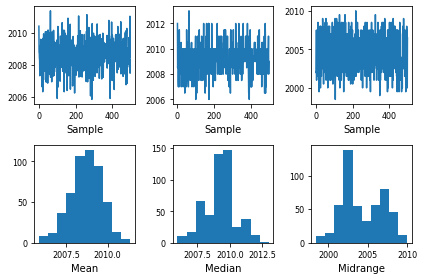

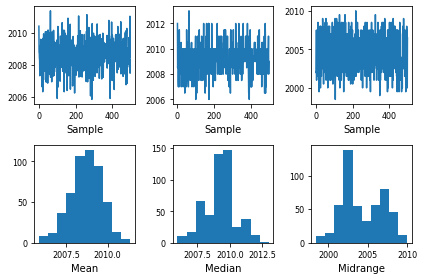

In [122]:
pd.plotting.bootstrap_plot(dfm['year'])

# Cluster Description

In [123]:
fig = px.scatter(dfm, x="year", y="articulos", color="Cluster", facet_col="Cluster")
fig.show()

In [124]:
fig4 = px.box(dfm,y='year',x='Cluster', color='Cluster') 
fig4 

In [125]:
fig4 = px.scatter(dfm,y='year',x='Cluster', color='Instituciones') 
fig4 
fig4.show(width=800, height=300)

In [126]:
fig4 = px.scatter(dfm,x='year',y='Instituciones', color='Cluster') 
fig4 

In [127]:
# all(round(dfm.year) != df.year)
## g = round(dfm.year) != dfm.year
## g.describe()
### g.value_counts('True')

## Cluster 0

In [128]:
df0 = dfm[dfm.Cluster == 0]
df0

,Instituciones,grupo,year,articulos,SJR_Q_Q1,SJR_Q_Q2,SJR_Q_Q3,SJR_Q_Q4,capitulos,innovaciones,...,integrantes,doctorado,maestria,Especializacion,pregrado,Investigador_Asociado,Investigador_Emerito,Investigador_Junior,Investigador Senior,Cluster
84,Asociación Hortifrutícola De Colombia - Asohof...,1,1999,480.0,70.0,43.0,63.0,75.0,134.0,1.0,...,64.0,27.0,16.0,1.0,13.0,3.0,1.0,2.0,5.0,0
197,Centro Internacional Para Prueba De Vacunas Y ...,1,1997,933.0,315.0,148.0,155.0,103.0,53.0,2.0,...,155.0,10.0,31.0,22.0,19.0,3.0,0.0,5.0,1.0,0
332,Corporación Centro Internacional De Entrenamie...,1,1990,455.0,229.0,44.0,68.0,7.0,11.0,0.0,...,131.0,27.0,29.0,4.0,62.0,1.0,1.0,6.0,1.0,0
333,Corporación Centro Internacional De Entrenamie...,1,1997,933.0,315.0,148.0,155.0,103.0,53.0,2.0,...,155.0,10.0,31.0,22.0,19.0,3.0,0.0,5.0,1.0,0
345,Corporación De Innovación Para El Desarrollo D...,1,1986,509.0,180.0,77.0,69.0,40.0,22.0,6.0,...,109.0,27.0,28.0,4.0,33.0,1.0,1.0,5.0,4.0,0
452,Dirección Seccional De Salud De Antioquia No A...,1,1989,413.0,86.0,30.0,74.0,23.0,52.0,11.0,...,100.0,25.0,26.0,7.0,22.0,2.0,1.0,6.0,7.0,0
633,Fundacion Valle Del Lili Avalado,3,2005,1523.0,452.0,269.0,284.0,198.0,94.0,3.0,...,198.0,13.0,48.0,24.0,29.0,3.0,0.0,7.0,2.0,0
686,Fundación Instituto De Inmunología De Colombia...,2,1995,749.0,400.0,106.0,26.0,11.0,28.0,6.0,...,252.0,89.0,68.0,10.0,58.0,5.0,1.0,32.0,8.0,0
896,Instituto Colombiano De Neuropedagogia No Avalado,1,1995,392.0,64.0,32.0,69.0,99.0,69.0,1.0,...,57.0,18.0,24.0,6.0,5.0,5.0,0.0,1.0,6.0,0
916,Instituto De Investigación De Recursos Biológi...,1,2010,442.0,189.0,58.0,53.0,27.0,629.0,0.0,...,158.0,30.0,70.0,8.0,39.0,2.0,0.0,15.0,1.0,0


In [129]:
fig = px.box(df0,x='year', y=['articulos','capitulos','trabajos_grado','innovaciones', 'libros', 'softwares'], points="all", color="Cluster")
fig.show()

In [130]:
fig = px.box(df0,x='year', y=['articulos','capitulos','trabajos_grado','innovaciones', 'libros', 'softwares'], points="all", color="Instituciones")
fig.show()

In [131]:
fig = px.scatter(df0, x="year", y="articulos", color="Instituciones", size="articulos")
fig.show()

## Cluster 1

In [132]:
df1 = dfm[dfm.Cluster == 1]
df1

,Instituciones,grupo,year,articulos,SJR_Q_Q1,SJR_Q_Q2,SJR_Q_Q3,SJR_Q_Q4,capitulos,innovaciones,...,integrantes,doctorado,maestria,Especializacion,pregrado,Investigador_Asociado,Investigador_Emerito,Investigador_Junior,Investigador Senior,Cluster
5,Academia Antioqueña De Historia No Avalado,1,2007,18.0,0.0,1.0,0.0,0.0,44.0,0.0,...,26.0,6.0,5.0,0.0,11.0,1.0,0.0,1.0,0.0,1
7,Academia Colombiana De La Lengua No Avalado,1,2000,102.0,0.0,0.0,1.0,0.0,44.0,0.0,...,20.0,14.0,4.0,0.0,1.0,1.0,1.0,1.0,0.0,1
8,Academia Peruana De Cirugia No Avalado,1,2013,18.0,0.0,1.0,4.0,1.0,52.0,2.0,...,18.0,3.0,13.0,1.0,0.0,0.0,0.0,4.0,0.0,1
11,Administradora Country S.A- Centro De Investig...,1,2001,188.0,7.0,2.0,24.0,53.0,4.0,0.0,...,50.0,3.0,7.0,4.0,21.0,1.0,0.0,2.0,1.0,1
22,Alcaldía De Medellin No Avalado,1,1984,239.0,5.0,2.0,8.0,16.0,22.0,0.0,...,37.0,5.0,13.0,2.0,9.0,0.0,0.0,1.0,0.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1429,University Of Missouri System No Avalado,1,2011,46.0,7.0,10.0,7.0,1.0,25.0,0.0,...,28.0,10.0,10.0,0.0,2.0,0.0,0.0,0.0,1.0,1
1430,University Of Western Australia No Avalado,1,2006,325.0,67.0,20.0,39.0,54.0,67.0,23.0,...,30.0,5.0,5.0,2.0,7.0,0.0,0.0,3.0,0.0,1
1431,Vedas Corporacion De Investigacion E Innovacio...,1,2015,59.0,44.0,5.0,1.0,3.0,2.0,0.0,...,13.0,12.0,0.0,0.0,0.0,1.0,0.0,6.0,0.0,1
1433,Veritas Aid Avalado,1,2008,6.0,0.0,0.0,1.0,0.0,25.0,1.0,...,40.0,5.0,13.0,1.0,4.0,0.0,0.0,1.0,0.0,1


In [133]:
fig = px.box(df1,x='year', y=['articulos','capitulos','trabajos_grado','innovaciones', 'libros', 'softwares'], points="all", color="Cluster")
fig.show()

fig = px.box(df1,x='year', y=['articulos','capitulos','trabajos_grado','innovaciones', 'libros', 'softwares'], points="all", color="Instituciones")
fig.show()


fig = px.scatter(df1, x="year", y="articulos", color="Instituciones", size="articulos")
fig.show()

## Cluster 2

In [134]:
df2 = dfm[dfm.Cluster == 2]
df2

,Instituciones,grupo,year,articulos,SJR_Q_Q1,SJR_Q_Q2,SJR_Q_Q3,SJR_Q_Q4,capitulos,innovaciones,...,integrantes,doctorado,maestria,Especializacion,pregrado,Investigador_Asociado,Investigador_Emerito,Investigador_Junior,Investigador Senior,Cluster
21,Alcaldia Municipal De Popayan No Avalado,1,2002,22.0,0.0,1.0,2.0,2.0,29.0,51.0,...,40.0,8.0,20.0,4.0,1.0,2.0,0.0,3.0,0.0,2
93,Audifarma S.A. No Avalado,1,2000,262.0,72.0,19.0,18.0,12.0,3.0,0.0,...,31.0,15.0,11.0,0.0,3.0,2.0,0.0,3.0,3.0,2
148,Centro De Bioinformatica Y Biologia Computacio...,1,2012,62.0,33.0,10.0,7.0,5.0,13.0,1.0,...,66.0,29.0,25.0,2.0,7.0,2.0,0.0,11.0,4.0,2
163,Centro De Estudios Y Asesorías En Ciencias Soc...,1,2000,171.0,2.0,2.0,3.0,2.0,68.0,0.0,...,42.0,15.0,12.0,1.0,8.0,4.0,2.0,2.0,3.0,2
185,Centro De Investigación Y Desarrollo Tecnológi...,2,1998,101.0,37.0,12.0,10.0,9.0,22.0,5.0,...,170.0,25.0,49.0,10.0,41.0,9.0,0.0,7.0,2.0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1342,Universidad Eia No Avalado,1,2006,124.0,28.0,12.0,23.0,8.0,26.0,0.0,...,59.0,21.0,21.0,0.0,11.0,2.0,0.0,6.0,5.0,2
1404,"Universidad Santo Tomás, Seccional Bucaramanga...",3,2005,201.0,24.0,10.0,25.0,11.0,133.0,3.0,...,171.0,44.0,48.0,12.0,39.0,5.0,2.0,8.0,2.0,2
1407,Universidad Simón Bolívar Avalado,44,2003,4054.0,676.0,332.0,864.0,716.0,2185.0,415.0,...,1588.0,402.0,543.0,105.0,278.0,117.0,8.0,121.0,72.0,2
1415,Universidad Tecnológica De Bolívar No Avalado,2,2006,203.0,35.0,19.0,65.0,41.0,74.0,37.0,...,93.0,35.0,32.0,3.0,8.0,7.0,1.0,9.0,17.0,2


In [135]:
fig = px.box(df2,x='year', y=['articulos','capitulos','trabajos_grado','innovaciones', 'libros', 'softwares'], points="all", color="Cluster")
fig.show()

fig = px.box(df2,x='year', y=['articulos','capitulos','trabajos_grado','innovaciones', 'libros', 'softwares'], points="all", color="Instituciones")
fig.show()


fig = px.scatter(df2, x="year", y="articulos", color="Instituciones", size="articulos")
fig.show()

## Cluster 3

In [136]:
df3 = dfm[dfm.Cluster == 3]
df3

,Instituciones,grupo,year,articulos,SJR_Q_Q1,SJR_Q_Q2,SJR_Q_Q3,SJR_Q_Q4,capitulos,innovaciones,...,integrantes,doctorado,maestria,Especializacion,pregrado,Investigador_Asociado,Investigador_Emerito,Investigador_Junior,Investigador Senior,Cluster
15,Agencia Para La Reincorporación Y La Normaliza...,1,2014,4.0,1.0,0.0,0.0,0.0,16.0,2.0,...,90.0,8.0,20.0,16.0,13.0,1.0,0.0,4.0,0.0,3
16,Agraf Industrial S.A. No Avalado,1,2014,15.0,0.0,0.0,1.0,1.0,38.0,0.0,...,68.0,1.0,21.0,11.0,6.0,0.0,0.0,0.0,0.0,3
17,Agremiacion De Gineco-Obstetras De Cartagena Y...,1,2007,235.0,55.0,32.0,18.0,17.0,50.0,1.0,...,131.0,1.0,9.0,6.0,52.0,0.0,0.0,2.0,1.0,3
32,Alzak Foundation Avalado,2,2004,176.0,118.0,14.0,10.0,4.0,7.0,1.0,...,105.0,12.0,34.0,9.0,28.0,2.0,0.0,8.0,2.0,3
37,Andina Diseñadores No Avalado,1,2014,4.0,0.0,0.0,0.0,0.0,3.0,2.0,...,53.0,1.0,11.0,9.0,12.0,0.0,0.0,2.0,0.0,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1355,"Universidad Interamericana De Puerto Rico, San...",1,2000,132.0,44.0,28.0,6.0,10.0,7.0,0.0,...,92.0,14.0,17.0,2.0,25.0,0.0,0.0,2.0,0.0,3
1369,Universidad Metropolitana De Ciencias De La Ed...,1,2011,64.0,5.0,5.0,7.0,22.0,11.0,0.0,...,75.0,2.0,16.0,6.0,12.0,0.0,0.0,3.0,2.0,3
1399,Universidad Santo Tomas Seccional Tunja Avalado,10,2010,783.0,28.0,16.0,31.0,26.0,269.0,43.0,...,491.0,89.0,210.0,51.0,96.0,7.0,0.0,26.0,1.0,3
1400,Universidad Santo Tomas Seccional Tunja No Ava...,1,2003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,68.0,14.0,21.0,3.0,9.0,0.0,1.0,2.0,0.0,3


In [137]:
fig = px.box(df3,x='year', y=['articulos','capitulos','trabajos_grado','innovaciones', 'libros', 'softwares'], points="all", color="Cluster")
fig.show()

fig = px.box(df3,x='year', y=['articulos','capitulos','trabajos_grado','innovaciones', 'libros', 'softwares'], points="all", color="Instituciones")
fig.show()


fig = px.scatter(df3, x="year", y="articulos", color="Instituciones", size="articulos")
fig.show()

## Cluster 4

In [138]:
df4 = dfm[dfm.Cluster == 4]
df4

,Instituciones,grupo,year,articulos,SJR_Q_Q1,SJR_Q_Q2,SJR_Q_Q3,SJR_Q_Q4,capitulos,innovaciones,...,integrantes,doctorado,maestria,Especializacion,pregrado,Investigador_Asociado,Investigador_Emerito,Investigador_Junior,Investigador Senior,Cluster
0,A.I.D Biohacking Colombia Avalado,1,2017,4.0,0.0,0.0,1.0,1.0,0.0,0.0,...,6.0,1.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,4
1,Aalborg University No Avalado,1,2012,10.0,1.0,3.0,1.0,2.0,4.0,0.0,...,13.0,7.0,1.0,0.0,3.0,0.0,0.0,1.0,0.0,4
2,Abogato Jurídico S.A.S. Avalado,1,2018,2.0,0.0,0.0,0.0,0.0,0.0,0.0,...,6.0,0.0,1.0,1.0,2.0,0.0,0.0,0.0,0.0,4
3,Abya-Ayala No Avalado,1,2014,9.0,0.0,0.0,2.0,7.0,0.0,0.0,...,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,4
4,Academia Américana De Psiquiatría No Avalado,1,2008,5.0,0.0,0.0,0.0,0.0,12.0,0.0,...,40.0,1.0,10.0,1.0,16.0,0.0,0.0,1.0,0.0,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1435,Vital Care Centro De Simulación Clinica Avalado,1,2015,10.0,2.0,0.0,2.0,0.0,0.0,1.0,...,14.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,4
1436,Vocology Center Avalado,1,2017,6.0,0.0,2.0,1.0,0.0,0.0,0.0,...,7.0,2.0,2.0,0.0,2.0,1.0,0.0,1.0,0.0,4
1439,"Yoluka Ong, Fundación De Investigación En Biod...",1,2008,25.0,2.0,4.0,7.0,2.0,18.0,0.0,...,6.0,1.0,3.0,0.0,2.0,0.0,0.0,2.0,0.0,4
1440,Zumo Tecnologia Avalado,1,2013,0.0,0.0,0.0,0.0,0.0,0.0,11.0,...,10.0,0.0,5.0,1.0,4.0,0.0,0.0,2.0,0.0,4


In [139]:
fig = px.box(df4,x='year', y=['articulos','capitulos','trabajos_grado','innovaciones', 'libros', 'softwares'], points="all", color="Cluster")
fig.show()

fig = px.box(df4,x='year', y=['articulos','capitulos','trabajos_grado','innovaciones', 'libros', 'softwares'], points="all", color="Instituciones")
fig.show()


fig = px.scatter(df4, x="year", y="articulos", color="Instituciones", size="articulos")
fig.show()

# Producción

In [140]:
dfy = dfm.year.value_counts(ascending=False).reset_index()
dfgy=dfy.round({"index":0, "year":2})
dfgy.columns =['Year', 'Cantidad']


In [141]:
dfgy.Year.value_counts(ascending=False).reset_index().unique=True
dfgy.sort_values('Year')
fig4 = px.scatter(dfgy,y ='Cantidad',x='Year') 
fig4 

In [142]:
dfgy = dfgy.sort_values(by=['Year'], ascending=False)

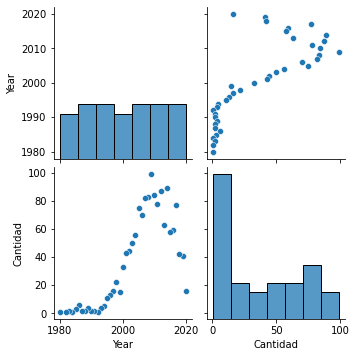

In [143]:
fgy = sns.pairplot(dfgy)

In [144]:
dfgy.columns

Index(['Year', 'Cantidad'], dtype='object')

In [145]:
# Cantidad años
conteo_años       = dfgy.groupby('Year').size()
conteo_años.values

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1])

In [146]:
años = dfgy.groupby('Year').sum().reset_index()[['Year','Cantidad']]
años
fig = px.bar(años, x="Year", y ='Cantidad', title="Años",text_auto=True)
fig.show()

In [147]:

fig4 = px.scatter(años,y ='Cantidad',x='Year', marginal_x='histogram',marginal_y='violin', trendline='ols') 
fig4 

In [148]:
años['log_cant'] = np.log(años.Cantidad)
fig4 = px.scatter(años,y ='log_cant',x='Year', marginal_x='histogram',marginal_y='violin', trendline='ols') 
fig4 

In [149]:
fig = px.scatter(años, x="Year", y="log_cant", size="log_cant")
fig.show()

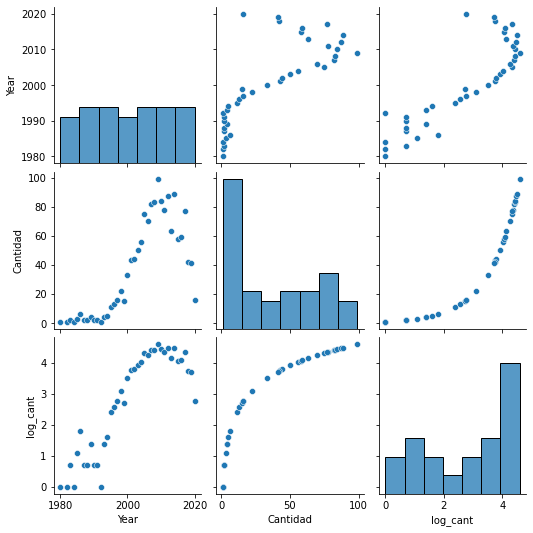

In [150]:
yy = sns.pairplot(años)

In [151]:
fig = px.line(años, x="Year", y="log_cant")
fig.show()

In [152]:
fig = px.scatter(años, x="Year", y="Cantidad", marginal_y="box")
fig.show()

In [153]:
años

,Year,Cantidad,log_cant
0,1980,1,0.000000
1,1982,1,0.000000
2,1983,2,0.693147
3,1984,1,0.000000
4,1985,3,1.098612
5,1986,6,1.791759
6,1987,2,0.693147
7,1988,2,0.693147
8,1989,4,1.386294
9,1990,2,0.693147


In [154]:
años.index

RangeIndex(start=0, stop=40, step=1)

In [155]:
np.log(años.index)

/Users/jmlz_rp/Library/Python/3.8/lib/python/site-packages/pandas/core/indexes/base.py:920: RuntimeWarning:

divide by zero encountered in log



Float64Index([              -inf,                0.0, 0.6931471805599453,
              1.0986122886681098, 1.3862943611198906, 1.6094379124341003,
               1.791759469228055, 1.9459101490553132, 2.0794415416798357,
              2.1972245773362196,  2.302585092994046, 2.3978952727983707,
              2.4849066497880004, 2.5649493574615367, 2.6390573296152584,
                2.70805020110221,  2.772588722239781,  2.833213344056216,
              2.8903717578961645, 2.9444389791664403,  2.995732273553991,
               3.044522437723423,  3.091042453358316, 3.1354942159291497,
              3.1780538303479458, 3.2188758248682006,  3.258096538021482,
               3.295836866004329,  3.332204510175204,  3.367295829986474,
              3.4011973816621555, 3.4339872044851463, 3.4657359027997265,
              3.4965075614664802, 3.5263605246161616, 3.5553480614894135,
                3.58351893845611, 3.6109179126442243, 3.6375861597263857,
              3.6635616461296463],
   

In [156]:
fig4 = px.line(años,y ='log_cant',x='Year') 
fig4 

## Grupos de investigacion

### Data

Cluster.infoGrupos.csv https://drive.google.com/drive/u/0/folders/1APVnfD1zPgTHFAr0YMG6UMTwZ52MQVa9

In [157]:
dfg = pd.read_csv("Cluster.infoGrupos.csv")
dfg

,Codigo del grupo,Nombre grupo,Lider,Avalado,Estado,Clasificado en,link_grupos,link_perfiles,Instituciones,fecha_creacion,...,trabajos_grado,integrantes,doctorado,Especializacion,maestria,pregrado,Investigador_Asociado,Investigador_Emerito,Investigador_Junior,Investigador Senior
0,COL0024623,Biotecnologia vegetal,Giovanni Orlando Cancino Escalante,1 de 1,Categoría C,Convocatoria 833 de 2018,https://scienti.minciencias.gov.co/gruplac/jsp...,https://scienti.minciencias.gov.co/gruplac/jsp...,Universidad De Pamplona Avalado,Febrero de 2003.,...,38.0,47.0,16.0,1.0,15.0,10.0,4.0,0.0,7.0,0.0
1,COL0137494,Grupo de investigación en agricultura biológica,Lucia Ana Diaz Ariza,1 de 2,Categoría C,Convocatoria 833 de 2018,https://scienti.minciencias.gov.co/gruplac/jsp...,https://scienti.minciencias.gov.co/gruplac/jsp...,Pontificia Universidad Javeriana Avalado,Octubre de 2011.,...,54.0,24.0,7.0,0.0,13.0,1.0,1.0,0.0,1.0,1.0
2,COL0102962,"Rg microbial ecology: metabolism, genomics & e...",Howard Junca Diaz,3 de 5,Grupo reconocido,Convocatoria 833 de 2018,https://scienti.minciencias.gov.co/gruplac/jsp...,https://scienti.minciencias.gov.co/gruplac/jsp...,Corporación Corpogen No Avalado,Enero de 2010.,...,5.0,6.0,4.0,0.0,0.0,1.0,1.0,0.0,3.0,0.0
3,COL0102962,"Rg microbial ecology: metabolism, genomics & e...",Howard Junca Diaz,3 de 5,Grupo reconocido,Convocatoria 833 de 2018,https://scienti.minciencias.gov.co/gruplac/jsp...,https://scienti.minciencias.gov.co/gruplac/jsp...,Asociacion Fundacion De Investigacion Microbio...,Enero de 2010.,...,5.0,6.0,4.0,0.0,0.0,1.0,1.0,0.0,3.0,0.0
4,COL0102962,"Rg microbial ecology: metabolism, genomics & e...",Howard Junca Diaz,3 de 5,Grupo reconocido,Convocatoria 833 de 2018,https://scienti.minciencias.gov.co/gruplac/jsp...,https://scienti.minciencias.gov.co/gruplac/jsp...,Compañia Campo Colombia Avalado,Enero de 2010.,...,5.0,6.0,4.0,0.0,0.0,1.0,1.0,0.0,3.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7886,COL0155269,Grupo de investigación socio jurídico - gisoju,NaN,3 de 6,Categoría C,Convocatoria 833 de 2018,https://scienti.minciencias.gov.co/gruplac/jsp...,https://scienti.minciencias.gov.co/gruplac/jsp...,Universidad Francisco De Paula Santander Ocaña...,Mayo de 2014.,...,34.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7887,COL0187772,"Parrhesía, grupo de investigación en filosofía...",NaN,1 de 1,Categoría C,Convocatoria 833 de 2018,https://scienti.minciencias.gov.co/gruplac/jsp...,https://scienti.minciencias.gov.co/gruplac/jsp...,Universitaria Agustiniana Avalado,Diciembre de 2014.,...,33.0,7.0,2.0,0.0,4.0,1.0,0.0,0.0,1.0,0.0
7888,COL0155699,"Trabajo social, derechos humanos y desarrollo ...",NaN,1 de 2,Grupo reconocido,Convocatoria 833 de 2018,https://scienti.minciencias.gov.co/gruplac/jsp...,https://scienti.minciencias.gov.co/gruplac/jsp...,Corporacion Universitaria Rafael Nuñez Avalado,Enero de 2013.,...,19.0,6.0,0.0,0.0,5.0,0.0,0.0,0.0,0.0,0.0
7889,COL0205253,"Investigación e innovación para la educación, ...",NaN,1 de 2,Categoría C,Convocatoria 833 de 2018,https://scienti.minciencias.gov.co/gruplac/jsp...,https://scienti.minciencias.gov.co/gruplac/jsp...,Organizacion De Estados Iberoamericanos Oei Av...,Enero de 2015.,...,18.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [158]:
dfg.columns

Index(['Codigo del grupo', 'Nombre grupo', 'Lider', 'Avalado', 'Estado',
       'Clasificado en', 'link_grupos', 'link_perfiles', 'Instituciones',
       'fecha_creacion', 'lugar_creacion', 'year', 'grupo', 'articulos',
       'SJR_Q_Q1', 'SJR_Q_Q2', 'SJR_Q_Q3', 'SJR_Q_Q4', 'SJR_Q_Sin categoria',
       'capitulos', 'innovaciones', 'libros', 'softwares', 'trabajos_grado',
       'integrantes', 'doctorado', 'Especializacion', 'maestria', 'pregrado',
       'Investigador_Asociado', 'Investigador_Emerito', 'Investigador_Junior',
       'Investigador Senior'],
      dtype='object')

In [159]:
dfg.T

,0,1,2,3,4,5,6,7,8,9,...,7881,7882,7883,7884,7885,7886,7887,7888,7889,7890
Codigo del grupo,COL0024623,COL0137494,COL0102962,COL0102962,COL0102962,COL0007829,COL0031449,COL0029138,COL0001029,COL0008871,...,COL0052252,COL0188072,COL0105347,COL0185169,COL0178915,COL0155269,COL0187772,COL0155699,COL0205253,COL0211751
Nombre grupo,Biotecnologia vegetal,Grupo de investigación en agricultura biológica,"Rg microbial ecology: metabolism, genomics & e...","Rg microbial ecology: metabolism, genomics & e...","Rg microbial ecology: metabolism, genomics & e...",Grupo de biotecnología-productos naturales,Alimentos y agroindustria,Sistemas agrícolas del trópico (sat),Bioprocesos y bioprospección,Grupo de investigaciones en ingenieria biomédi...,...,"Grupo de investigación en diseńo, imagen y com...",Grupo de investigación ceinfes,Grupo de investigaciones empresariales (grinem),Estudios y análisis del espacio público,Diseńo y comunicación audiovisual,Grupo de investigación socio jurídico - gisoju,"Parrhesía, grupo de investigación en filosofía...","Trabajo social, derechos humanos y desarrollo ...","Investigación e innovación para la educación, ...",Grupo de estudios creativos de la universidad ...
Lider,Giovanni Orlando Cancino Escalante,Lucia Ana Diaz Ariza,Howard Junca Diaz,Howard Junca Diaz,Howard Junca Diaz,Oscar Marino Mosquera Martinez,Oscar Julian Sanchez Toro,Angela Arcila Cardona,Dolly Montoya Castano,Clara Eugenia Goyes Lopez,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Avalado,1 de 1,1 de 2,3 de 5,3 de 5,3 de 5,1 de 1,1 de 1,1 de 1,1 de 1,1 de 1,...,1 de 1,1 de 1,2 de 3,1 de 1,1 de 1,3 de 6,1 de 1,1 de 2,1 de 2,1 de 2
Estado,Categoría C,Categoría C,Grupo reconocido,Grupo reconocido,Grupo reconocido,Categoría B,Categoría A1,Categoría A1,Categoría A,Categoría A,...,Categoría B,Categoría C,Categoría 00,Categoría C,Categoría C,Categoría C,Categoría C,Grupo reconocido,Categoría C,Categoría 00
Clasificado en,Convocatoria 833 de 2018,Convocatoria 833 de 2018,Convocatoria 833 de 2018,Convocatoria 833 de 2018,Convocatoria 833 de 2018,Convocatoria 833 de 2018,Convocatoria 833 de 2018,Convocatoria 833 de 2018,Convocatoria 833 de 2018,Convocatoria 833 de 2018,...,Convocatoria 833 de 2018,Convocatoria 833 de 2018,Convocatoria 833 de 2018,Convocatoria 833 de 2018,Convocatoria 833 de 2018,Convocatoria 833 de 2018,Convocatoria 833 de 2018,Convocatoria 833 de 2018,Convocatoria 833 de 2018,Sin Reconocer
link_grupos,https://scienti.minciencias.gov.co/gruplac/jsp...,https://scienti.minciencias.gov.co/gruplac/jsp...,https://scienti.minciencias.gov.co/gruplac/jsp...,https://scienti.minciencias.gov.co/gruplac/jsp...,https://scienti.minciencias.gov.co/gruplac/jsp...,https://scienti.minciencias.gov.co/gruplac/jsp...,https://scienti.minciencias.gov.co/gruplac/jsp...,https://scienti.minciencias.gov.co/gruplac/jsp...,https://scienti.minciencias.gov.co/gruplac/jsp...,https://scienti.minciencias.gov.co/gruplac/jsp...,...,https://scienti.minciencias.gov.co/gruplac/jsp...,https://scienti.minciencias.gov.co/gruplac/jsp...,https://scienti.minciencias.gov.co/gruplac/jsp...,https://scienti.minciencias.gov.co/gruplac/jsp...,https://scienti.minciencias.gov.co/gruplac/jsp...,https://scienti.minciencias.gov.co/gruplac/jsp...,https://scienti.minciencias.gov.co/gruplac/jsp...,https://scienti.minciencias.gov.co/gruplac/jsp...,https://scienti.minciencias.gov.co/gruplac/jsp...,https://scienti.minciencias.gov.co/gruplac/jsp...
link_perfiles,https://scienti.minciencias.gov.co/gruplac/jsp...,https://scienti.minciencias.gov.co/gruplac/jsp...,https://scienti.minciencias.gov.co/gruplac/jsp...,https://scienti.minciencias.gov.co/gruplac/jsp...,https://scienti.minciencias.gov.co/gruplac/jsp...,https://scienti.minciencias.gov.co/gruplac/jsp...,https://scienti.minciencias.gov.co/gruplac/jsp...,https://scienti.minciencias.gov.co/gruplac/jsp...,https://scienti.minciencias.gov.co/gruplac/jsp...,https://scienti.minciencias.gov.co/gruplac/jsp...,...,https://scienti.minciencias.gov.co/gruplac

<AxesSubplot:>

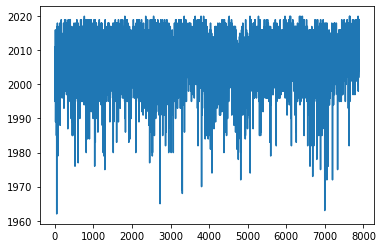

In [160]:
dfg ['year'].plot()

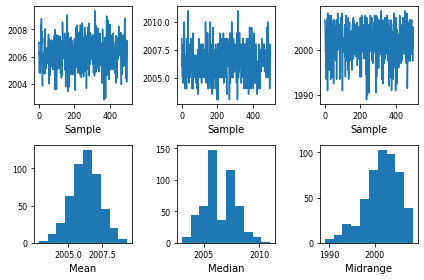

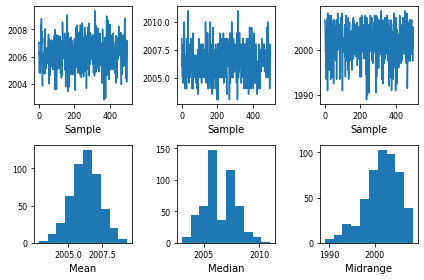

In [161]:
pd.plotting.bootstrap_plot(dfg['year'])

In [162]:
dfgy1 = dfg.year.value_counts(ascending=False).reset_index()
#dfgy1=dfgy1.round({"index":0, "year":2})
dfgy1.columns =['Year', 'Cantidad']

In [163]:
dfgy1.Year.value_counts(ascending=False).reset_index().unique=True
dfgy1.sort_values('Year')
fig4 = px.scatter(dfgy1,y ='Cantidad',x='Year') 
fig4 

In [164]:
años1 = dfgy1.groupby('Year').sum().reset_index()[['Year','Cantidad']]
años1
fig = px.bar(años1, x="Year", y ='Cantidad', title="Años",text_auto=True)
fig.show()

In [165]:
años1['log_cant'] = np.log(años1.Cantidad)
fig4 = px.scatter(años1,y ='log_cant',x='Year', marginal_x='histogram',marginal_y='violin', trendline='ols') 
fig4 

# Articulos

articulos.csv https://drive.google.com/drive/u/0/folders/13luRLLwEeD37O3TNgZ_c5nONGcMSTPh-

In [166]:
articulos = pd.read_csv('/Users/jmlz_rp/Documents/BIOS/BIOS_rar/Datos/Datos sin procesar/Categorias minciencias/articulos.csv')
#articulos = pd.read_csv('articulos.csv')
articulos

,titulo,doi,issn,autores,tipo_articulo,anio,grupo,sjr_q,revista,publindex,codigo_grupo
0,Regression analysis of the factors affecting e...,10.18041/2619-4244/dl.29.7861,1240099,"Daniel Francisco Cancino Ricketts, Giovanni Or...",Publicado en revista especializada,2021,Biotecnologia vegetal,NaN,NaN,NaN,COL0024623
1,Aplicacion del modelo de ajuste parcial nerlov...,10.22267/rtend.212202.168,25390554,"Susan Cancino Ricketts, Giovanni Orlando Canci...",Publicado en revista especializada,2021,Biotecnologia vegetal,NaN,NaN,NaN,COL0024623
2,Estimation of peach supply response in colombi...,10.18041/1900-3803/entramado.1.7243,19003803,"Susan Cancino Ricketts, Giovanni Orlando Canci...",Publicado en revista especializada,2021,Biotecnologia vegetal,NaN,NaN,NaN,COL0024623
3,Estimacion de una funcion de costos del arroz ...,NaN,18082882,"Susan Cancino Ricketts, Giovanni Orlando Canci...",Publicado en revista especializada,2020,Biotecnologia vegetal,Q3,CustoseAgronegocio,B,COL0024623
4,Modelo sistemico turistico para el municipio d...,10.15649/2346030X.777,2346030X,"Susan Cancino Ricketts, Jazmin Ortiz Florez, G...",Publicado en revista especializada,2020,Biotecnologia vegetal,NaN,NaN,NaN,COL0024623
...,...,...,...,...,...,...,...,...,...,...,...
349798,Structural design of an agricultural backhoe u...,10.1016/j.compag.2020.105278,1681699,"Victor Alfonso Alcantar Camarena, Alberto Sald...",Publicado en revista especializada,2020,"Investigación e innovación para la educación, ...",Q1,COMPUTERSANDELECTRONICSINAGRICULTURE,A1,COL0205253
349799,Corrosion behavior of boride diffusion layer o...,10.1016/j.wear.2021.203825.,9714588,Alberto Saldana Robles,Publicado en revista especializada,2020,"Investigación e innovación para la educación, ...",Q3,INDIANJOURLOFENGINEERINGANDMATERIALSSCIENCES,A2,COL0205253
349800,Analisis legal y jurisprudencial del fenomeno ...,NaN,20779038,Roberto Sicard Leon,Publicado en revista especializada,2020,"Investigación e innovación para la educación, ...",NaN,NaN,NaN,COL0205253
349801,The effects of surface roughness on the hemmin...,10.1007/s40430-019-2167-z,16785878,Alberto Saldana Robles,Publicado en revista especializada,2019,"Investigación e innovación para la educación, ...",Q2,JournaloftheBrazilianSocietyofMechanicalScienc...,A2,COL0205253


In [167]:
articulos.columns

Index(['titulo', 'doi', 'issn', 'autores', 'tipo_articulo', 'anio', 'grupo',
       'sjr_q', 'revista', 'publindex', 'codigo_grupo'],
      dtype='object')

In [168]:
a = articulos.anio.sort_values(ascending=True)

In [169]:
a.tail()

70046     9671
296145    9773
19004     9773
296144    9773
19008     9773
Name: anio, dtype: int64

In [170]:
a.head()

234427    0
203878    0
46762     0
241750    0
169835    0
Name: anio, dtype: int64

In [171]:
a.describe()

count    349803.000000
mean       2013.505802
std         114.652477
min           0.000000
25%        2008.000000
50%        2014.000000
75%        2018.000000
max        9773.000000
Name: anio, dtype: float64

In [172]:
a.shape

(349803,)

In [173]:
fig = px.scatter(articulos,x='anio', y='grupo')
fig.update_xaxes(range=[1900,2025])
fig


In [174]:
articulos

,titulo,doi,issn,autores,tipo_articulo,anio,grupo,sjr_q,revista,publindex,codigo_grupo
0,Regression analysis of the factors affecting e...,10.18041/2619-4244/dl.29.7861,1240099,"Daniel Francisco Cancino Ricketts, Giovanni Or...",Publicado en revista especializada,2021,Biotecnologia vegetal,NaN,NaN,NaN,COL0024623
1,Aplicacion del modelo de ajuste parcial nerlov...,10.22267/rtend.212202.168,25390554,"Susan Cancino Ricketts, Giovanni Orlando Canci...",Publicado en revista especializada,2021,Biotecnologia vegetal,NaN,NaN,NaN,COL0024623
2,Estimation of peach supply response in colombi...,10.18041/1900-3803/entramado.1.7243,19003803,"Susan Cancino Ricketts, Giovanni Orlando Canci...",Publicado en revista especializada,2021,Biotecnologia vegetal,NaN,NaN,NaN,COL0024623
3,Estimacion de una funcion de costos del arroz ...,NaN,18082882,"Susan Cancino Ricketts, Giovanni Orlando Canci...",Publicado en revista especializada,2020,Biotecnologia vegetal,Q3,CustoseAgronegocio,B,COL0024623
4,Modelo sistemico turistico para el municipio d...,10.15649/2346030X.777,2346030X,"Susan Cancino Ricketts, Jazmin Ortiz Florez, G...",Publicado en revista especializada,2020,Biotecnologia vegetal,NaN,NaN,NaN,COL0024623
...,...,...,...,...,...,...,...,...,...,...,...
349798,Structural design of an agricultural backhoe u...,10.1016/j.compag.2020.105278,1681699,"Victor Alfonso Alcantar Camarena, Alberto Sald...",Publicado en revista especializada,2020,"Investigación e innovación para la educación, ...",Q1,COMPUTERSANDELECTRONICSINAGRICULTURE,A1,COL0205253
349799,Corrosion behavior of boride diffusion layer o...,10.1016/j.wear.2021.203825.,9714588,Alberto Saldana Robles,Publicado en revista especializada,2020,"Investigación e innovación para la educación, ...",Q3,INDIANJOURLOFENGINEERINGANDMATERIALSSCIENCES,A2,COL0205253
349800,Analisis legal y jurisprudencial del fenomeno ...,NaN,20779038,Roberto Sicard Leon,Publicado en revista especializada,2020,"Investigación e innovación para la educación, ...",NaN,NaN,NaN,COL0205253
349801,The effects of surface roughness on the hemmin...,10.1007/s40430-019-2167-z,16785878,Alberto Saldana Robles,Publicado en revista especializada,2019,"Investigación e innovación para la educación, ...",Q2,JournaloftheBrazilianSocietyofMechanicalScienc...,A2,COL0205253


In [175]:
dfgya = articulos.anio.value_counts(ascending=False).reset_index()
#dfgy1=dfgy1.round({"index":0, "year":2})
dfgya.columns =['Year', 'Cantidad']

In [176]:

dfgya.Year.value_counts(ascending=False).reset_index().unique=True
dfgya.sort_values('Year')
#fig4 = px.scatter(dfgya,y ='Cantidad',x='Year') 
#fig4 

,Year,Cantidad
130,0,6
449,15,1
385,19,1
442,106,1
373,122,1
...,...,...
503,9061,1
291,9126,2
184,9501,4
308,9671,2


In [177]:
añosa = dfgya.groupby('Year').sum().reset_index()[['Year','Cantidad']]
#fig = px.bar(añosa, x="Year", y ='Cantidad', title="Años",text_auto=True)
#fig.show()

In [178]:
añosa['log_cant'] = np.log(añosa.Cantidad)
#fig4 = px.scatter(añosa,y ='log_cant',x='Year', marginal_x='histogram',marginal_y='violin', trendline='ols') 
#fig4 

In [183]:
añosa1 = añosa[(añosa['Year'] >= 1970) & (añosa['Year'] <= 2023)]
añosa1

,Year,Cantidad,log_cant
330,1970,42,3.737670
331,1971,18,2.890372
332,1972,11,2.397895
333,1973,29,3.367296
334,1974,29,3.367296
335,1975,39,3.663562
336,1976,23,3.135494
337,1977,47,3.850148
338,1978,60,4.094345
339,1979,49,3.891820


In [180]:
fig4 = px.scatter(añosa1,y ='Cantidad',x='Year') 
fig4 

In [181]:
fig = px.bar(añosa1, x="Year", y ='Cantidad', title="Años",text_auto=True)
fig.show()

In [182]:
fig4 = px.scatter(añosa1,y ='log_cant',x='Year', marginal_x='histogram',marginal_y='violin', trendline='ols') 
fig4 